In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud
import circlify
import squarify

In [3]:
batting_stats = pd.read_csv('./batsmen_stats.csv', index_col=0)
bowling_stats = pd.read_csv('./bowling_stats.csv', index_col=0)
                                                                                    

In [4]:
batting_stats

,innings,second_innings_notouts,first_innings_notouts,combined_notouts,balls_faced,total_runs,highest_score,average,strike_rate,50s,...,avg_pp,avg_mo,avg_death,avg_first,avg_second,sr_pp,sr_mo,sr_death,sr_first,sr_second
A Ashish Reddy,23,2,6,8,193,280,36,18.67,145.08,0.0,...,5.00,12.20,15.29,23.71,14.25,83.33,148.78,146.58,146.90,142.50
A Badoni,11,2,1,3,130,161,54,20.12,123.85,1.0,...,1.00,19.67,25.25,26.50,13.75,16.67,101.72,153.03,123.26,125.00
A Chandila,2,0,2,2,7,4,4,0.00,57.14,0.0,...,0.00,0.00,2.00,2.00,0.00,0.00,0.00,57.14,57.14,0.00
A Chopra,6,0,0,0,71,53,24,8.83,74.65,0.0,...,9.00,12.50,1.00,10.20,2.00,69.23,83.33,50.00,75.00,66.67
A Choudhary,3,1,1,2,20,25,15,25.00,125.00,0.0,...,0.00,0.00,25.00,15.00,10.00,0.00,0.00,125.00,125.00,125.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Yash Dayal,1,0,0,0,1,0,0,0.00,0.00,0.0,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
Yashpal Singh,4,0,0,0,66,47,20,11.75,71.21,0.0,...,17.00,6.50,17.00,13.00,11.33,47.22,76.47,130.77,65.00,73.91
Younis Khan,1,0,0,0,7,3,3,3.00,42.86,0.0,...,3.00,0.00,0.00,0.00,3.00,42.86,0.00,0.00,0.00,42.86
Yuvraj Singh,126,10,5,15,2120,2750,83,24.77,129.72,13.0,...,15.75,29.04,21.57,24.75,24.80,102.72,115.33,180.84,138.41,120.51


In [5]:
bowling_stats

,bowl_innings,balls_bowled,runs_given,wickets,economy,bowl_avg,bowl_sr,BBI,3w,4w,...,wickets_taken_in_first_innings,runs_given_in_second_innings,balls_bowled_in_second_innings,wickets_taken_in_second_innings,economy_in_first_innings,economy_in_second_innings,bowl_avg_in_first_innings,bowl_avg_in_second_innings,bowl_sr_in_first_innings,bowl_sr_in_second_innings
A Ashish Reddy,20,262,396,18,9.07,22.00,14.56,3/25,1,0,...,7,251,167,11,9.16,9.02,20.71,22.82,13.57,15.18
A Badoni,2,12,11,2,5.50,5.50,6.00,1/5,0,0,...,1,6,6,1,5.00,6.00,5.00,6.00,6.00,6.00
A Chandila,12,234,242,11,6.21,22.00,21.27,4/13,0,1,...,3,100,114,8,7.10,5.26,47.33,12.50,40.00,14.25
A Choudhary,5,101,144,5,8.55,28.80,20.20,2/17,0,0,...,3,72,53,2,9.00,8.15,24.00,36.00,16.00,26.50
A Dananjaya,1,24,47,0,11.75,0.00,0.00,0/47,0,0,...,0,47,24,0,0.00,11.75,0.00,0.00,0.00,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
YK Pathan,82,1147,1415,42,7.40,33.69,27.31,3/20,3,0,...,27,597,481,15,7.37,7.45,30.30,39.80,24.67,32.07
YS Chahal,130,2856,3624,166,7.61,21.83,17.20,5/40,11,3,...,73,1992,1613,93,7.88,7.41,22.36,21.42,17.03,17.34
Yash Dayal,9,192,296,11,9.25,26.91,17.45,3/40,1,0,...,4,141,84,7,8.61,10.07,38.75,20.14,27.00,12.00
Yuvraj Singh,73,869,1077,36,7.44,29.92,24.14,4/29,2,2,...,16,532,431,20,7.47,7.41,34.06,26.60,27.38,21.55


In [115]:
# player_list = pd.read_html('https://www.iplt20.com/auction')[1]
player_list = pd.read_csv('ipl_player_aution_list.csv')

In [116]:
# team_purse = pd.read_html('https://www.iplt20.com/auction')[0]
team_purse = pd.read_csv('ipl_team_purse.csv')

In [117]:
player_list[player_list['TYPE'] == 'All-Rounder'].head(20)

,PLAYER,NATIONALITY,TYPE,BASE PRICE
2,Sam Curran,Overseas,All-Rounder,20000000
3,Cameron Green,Overseas,All-Rounder,20000000
4,Jason Holder,Overseas,All-Rounder,20000000
5,Ben Stokes,Overseas,All-Rounder,20000000
14,Jimmy Neesham,Overseas,All-Rounder,20000000
16,Jamie Overton,Overseas,All-Rounder,20000000
17,Craig Overton,Overseas,All-Rounder,20000000
20,Shakib Al Hasan,Overseas,All-Rounder,15000000
28,Sean Abbott,Overseas,All-Rounder,15000000
37,Daryl Mitchell,Overseas,All-Rounder,10000000


In [118]:
# team_purse.to_csv('ipl_team_purse.csv', index=False)
# player_list.to_csv('ipl_player_aution_list.csv', index=False)

In [119]:
player_list.head(50)

,PLAYER,NATIONALITY,TYPE,BASE PRICE
0,Rilee Rossouw,Overseas,Batter,20000000
1,Kane Williamson,Overseas,Batter,20000000
2,Sam Curran,Overseas,All-Rounder,20000000
3,Cameron Green,Overseas,All-Rounder,20000000
4,Jason Holder,Overseas,All-Rounder,20000000
5,Ben Stokes,Overseas,All-Rounder,20000000
6,Tom Banton,Overseas,Wicket-Keeper,20000000
7,Nicholas Pooran,Overseas,Wicket-Keeper,20000000
8,Phil Salt,Overseas,Wicket-Keeper,20000000
9,Chris Jordan,Overseas,Bowler,20000000


In [120]:
player_list.iloc[50:101].head(50)

,PLAYER,NATIONALITY,TYPE,BASE PRICE
50,Reece Topley,Overseas,Bowler,7500000
51,Wayne Parnell,Overseas,All-Rounder,7500000
52,Daniel Sams,Overseas,All-Rounder,7500000
53,Joshua Philippe,Overseas,Wicket-Keeper,7500000
54,Ish Sodhi,Overseas,Bowler,7500000
55,Tom Curran,Overseas,All-Rounder,7500000
56,Darcy Short,Overseas,All-Rounder,7500000
57,David Payne,Overseas,Bowler,7500000
58,Carlos Brathwaite,Overseas,All-Rounder,7500000
59,Ajinkya Rahane,Indian,Batter,5000000


In [121]:
player_list['TYPE'].unique()

array(['Batter', 'All-Rounder', 'Wicket-Keeper', 'Bowler'], dtype=object)

In [122]:
player_list[player_list['TYPE'] == 'Wicket-Keeper']

,PLAYER,NATIONALITY,TYPE,BASE PRICE
6,Tom Banton,Overseas,Wicket-Keeper,20000000
7,Nicholas Pooran,Overseas,Wicket-Keeper,20000000
8,Phil Salt,Overseas,Wicket-Keeper,20000000
32,Heinrich Klaasen,Overseas,Wicket-Keeper,10000000
40,Shai Hope,Overseas,Wicket-Keeper,10000000
41,Tom Latham,Overseas,Wicket-Keeper,10000000
53,Joshua Philippe,Overseas,Wicket-Keeper,7500000
62,Litton Das,Overseas,Wicket-Keeper,5000000
63,Kusal Mendis,Overseas,Wicket-Keeper,5000000
75,Johnson Charles,Overseas,Wicket-Keeper,5000000


In [195]:
name = 'Garg'

In [196]:
sum(batting_stats.index.str.contains(name, case=False, regex=True))

1

In [197]:
# find player
batting_stats[batting_stats.index.str.contains(name, case=False, regex=True)]

,innings,second_innings_notouts,first_innings_notouts,combined_notouts,balls_faced,total_runs,highest_score,average,strike_rate,50s,100s,30s,6s,4s,runs_scored_in_pp,balls_faced_in_pp,innings_pp,notouts_pp,runs_scored_in_mo,balls_faced_in_mo,innings_mo,notouts_mo,runs_scored_in_death,balls_faced_in_death,innings_death,notouts_death,runs_scored_in_first_innings,balls_faced_in_first_innings,innings_first,notouts_first,runs_scored_in_second_innings,balls_faced_in_second_innings,innings_second,notouts_second,avg_pp,avg_mo,avg_death,avg_first,avg_second,sr_pp,sr_mo,sr_death,sr_first,sr_second,50s_in_first_innings,100s_in_first_innings,50s_in_second_innings,100s_in_second_innings,combined_milestones,pct_of_milestones,adj_pct_of_milestones
PK Garg,17,0,1,1,218,251,51,15.69,115.14,1.0,0.0,1.0,9.0,15.0,41.0,37.0,4.0,2.0,146.0,143.0,12.0,3.0,64.0,38.0,6.0,1.0,155.0,120.0,8.0,1.0,96.0,98.0,9.0,0.0,20.5,16.22,12.8,22.14,10.67,110.81,102.1,168.42,129.17,97.96,1.0,0.0,0.0,0.0,2.0,11.76,1.0


In [198]:
bowling_stats[bowling_stats.index.str.contains(name, case=False, regex=True)]

,bowl_innings,balls_bowled,runs_given,wickets,economy,bowl_avg,bowl_sr,BBI,3w,4w,5w,0w,pct_of_getting_wicket_each_match,runs_given_in_pp,balls_bowled_in_pp,wickets_taken_in_pp,runs_given_in_mo,balls_bowled_in_mo,wickets_taken_in_mo,runs_given_in_death,balls_bowled_in_death,wickets_taken_in_death,economy_in_pp,economy_in_mo,economy_in_death,bowl_avg_in_pp,bowl_avg_in_mo,bowl_avg_in_death,bowl_sr_in_pp,bowl_sr_in_mo,bowl_sr_in_death,runs_given_in_first_innings,balls_bowled_in_first_innings,wickets_taken_in_first_innings,runs_given_in_second_innings,balls_bowled_in_second_innings,wickets_taken_in_second_innings,economy_in_first_innings,economy_in_second_innings,bowl_avg_in_first_innings,bowl_avg_in_second_innings,bowl_sr_in_first_innings,bowl_sr_in_second_innings


In [127]:
allrounder_players_list = [
    'SM Curran', 'JO Holder', 'BA Stokes',
    'JDS Neesham', 'Shakib Al Hasan', 'SA Abbott',
    'DJ Mitchell', 'Mohammad Nabi', 'D Wiese',
    'MC Henriques', 'WD Parnell', 'DR Sams',
    'TK Curran', 'DJM Short', 'CR Brathwaite',
    'OF Smith', 'R Shepherd', 'GHS Garton',
    'FA Allen', 'P Negi', 'KMA Paul',
    'PK Garg', 'J Suchith', 'Swapnil Singh',
]

batsmen_players_list = [
    'RR Rossouw', 'KS Williamson', 'TM Head',
    'HE van der Dussen', 'CA Lynn', 'Dawid Malan',
    'SE Rutherford', 'JJ Roy', 'MA Agarwal',
    'MK Pandey', 'AM Rahane', 'Mandeep Singh',
    'KK Nair', 'Gurkeerat Singh', 'Anmolpreet Singh',
    'Sachin Baby',
]

bowler_players_list = [
    'CJ Jordan', 'AF Milne', 'TS Mills',
    'JA Richardson', 'A Zampa', 'RP Meredith',
    'NM Coulter-Nile', 'Mujeeb Ur Rahman', 'T Shamsi',
    'KA Jamieson', 'AJ Tye', 'IS Sodhi',
    'I Sharma', 'JD Unadkat', 'M Markande',
    'PVD Chameera', 'Sandeep Sharma', 'PP Chawla',
    'A Mishra', 'S Nadeem', 'MM Sharma',
    'B Stanlake', 'VR Aaron', 'SS Cottrell',
    'DS Kulkarni', 'BB Sran', 'KM Asif', 
    'VG Arora', 'M Ashwin', 'S Gopal',
    'S Midhun', 'IC Porel', 'Basil Thampi',
    'AS Rajpoot',
]

wicket_keeper_players_list = [
    'T Banton', 'N Pooran', 'H Klaasen',
    'JR Philippe', 'KS Bharat', 'N Jagadeesan',
    'B Indrajith', 'RK Bhui', 'SP Jackson',
    'A Tomar',
]

In [134]:
print(len(batsmen_players_list) + len(bowler_players_list) + len(wicket_keeper_players_list) + len(allrounder_players_list))

84


In [136]:
batting_stats.columns.tolist() + bowling_stats.columns.tolist()

['innings',
 'second_innings_notouts',
 'first_innings_notouts',
 'combined_notouts',
 'balls_faced',
 'total_runs',
 'highest_score',
 'average',
 'strike_rate',
 '50s',
 '100s',
 '30s',
 '6s',
 '4s',
 'runs_scored_in_pp',
 'balls_faced_in_pp',
 'innings_pp',
 'notouts_pp',
 'runs_scored_in_mo',
 'balls_faced_in_mo',
 'innings_mo',
 'notouts_mo',
 'runs_scored_in_death',
 'balls_faced_in_death',
 'innings_death',
 'notouts_death',
 'runs_scored_in_first_innings',
 'balls_faced_in_first_innings',
 'innings_first',
 'notouts_first',
 'runs_scored_in_second_innings',
 'balls_faced_in_second_innings',
 'innings_second',
 'notouts_second',
 'avg_pp',
 'avg_mo',
 'avg_death',
 'avg_first',
 'avg_second',
 'sr_pp',
 'sr_mo',
 'sr_death',
 'sr_first',
 'sr_second',
 '50s_in_first_innings',
 '100s_in_first_innings',
 '50s_in_second_innings',
 '100s_in_second_innings',
 'bowl_innings',
 'balls_bowled',
 'runs_given',
 'wickets',
 'economy',
 'bowl_avg',
 'bowl_sr',
 'BBI',
 '3w',
 '4w',
 '5w',


In [137]:
batting_stats = batting_stats.merge(combined_milestones.drop('innings',axis=1), left_index=True, right_index=True)

In [200]:
allrounder_df = batting_stats.loc[allrounder_players_list].merge(
    bowling_stats.loc[bowling_stats.index.intersection(allrounder_players_list)], left_index=True, right_index=True, how='left')

In [201]:
allrounder_df

,innings,second_innings_notouts,first_innings_notouts,combined_notouts,balls_faced,total_runs,highest_score,average,strike_rate,50s,100s,30s,6s,4s,runs_scored_in_pp,balls_faced_in_pp,innings_pp,notouts_pp,runs_scored_in_mo,balls_faced_in_mo,innings_mo,notouts_mo,runs_scored_in_death,balls_faced_in_death,innings_death,notouts_death,runs_scored_in_first_innings,balls_faced_in_first_innings,innings_first,notouts_first,runs_scored_in_second_innings,balls_faced_in_second_innings,innings_second,notouts_second,avg_pp,avg_mo,avg_death,avg_first,avg_second,sr_pp,sr_mo,sr_death,sr_first,sr_second,50s_in_first_innings,100s_in_first_innings,50s_in_second_innings,100s_in_second_innings,combined_milestones,pct_of_milestones,adj_pct_of_milestones,bowl_innings,balls_bowled,runs_given,wickets,economy,bowl_avg,bowl_sr,BBI,3w,4w,5w,0w,pct_of_getting_wicket_each_match,runs_given_in_pp,balls_bowled_in_pp,wickets_taken_in_pp,runs_given_in_mo,balls_bowled_in_mo,wickets_taken_in_mo,runs_given_in_death,balls_bowled_in_death,wickets_taken_in_death,economy_in_pp,economy_in_mo,economy_in_death,bowl_avg_in_pp,bowl_avg_in_mo,bowl_avg_in_death,bowl_sr_in_pp,bowl_sr_in_mo,bowl_sr_in_death,runs_given_in_first_innings,balls_bowled_in_first_innings,wickets_taken_in_first_innings,runs_given_in_second_innings,balls_bowled_in_second_innings,wickets_taken_in_second_innings,economy_in_first_innings,economy_in_second_innings,bowl_avg_in_first_innings,bowl_avg_in_second_innings,bowl_sr_in_first_innings,bowl_sr_in_second_innings
SM Curran,23,7,1,8,225,337,55,22.47,149.78,2.0,0.0,2.0,18.0,30.0,68.0,52.0,5.0,2.0,58.0,59.0,9.0,5.0,211.0,114.0,16.0,8.0,236.0,161.0,11.0,1.0,101.0,64.0,12.0,7.0,22.67,14.50,26.38,23.60,20.20,130.77,98.31,185.09,146.58,157.81,2.0,0.0,0.0,0.0,4.0,17.39,3.0,31.0,648.0,995.0,32.0,9.21,31.09,20.25,4/11,4.0,1.0,0.0,13.0,58.06,424.0,324.0,8.0,180.0,114.0,4.0,391.0,210.0,20.0,7.85,9.47,11.17,53.00,45.00,19.55,40.50,28.50,10.50,483.0,342.0,16.0,512.0,306.0,16.0,8.47,10.04,30.19,32.00,21.38,19.12
JO Holder,24,3,2,5,200,247,47,13.00,123.50,0.0,0.0,1.0,17.0,13.0,12.0,18.0,2.0,1.0,62.0,50.0,8.0,6.0,173.0,132.0,20.0,4.0,97.0,76.0,11.0,2.0,150.0,124.0,13.0,3.0,12.00,31.00,10.81,10.78,15.00,66.67,124.00,131.06,127.63,120.97,0.0,0.0,0.0,0.0,1.0,4.17,1.0,38.0,824.0,1177.0,49.0,8.57,24.02,16.82,4/52,7.0,1.0,0.0,14.0,63.16,463.0,318.0,9.0,358.0,279.0,12.0,356.0,227.0,28.0,8.74,7.70,9.41,51.44,29.83,12.71,35.33,23.25,8.11,622.0,450.0,31.0,555.0,374.0,18.0,8.29,8.90,20.06,30.83,14.52,20.78
BA Stokes,42,4,2,6,684,920,107,25.56,134.50,2.0,2.0,7.0,32.0,79.0,239.0,180.0,16.0,8.0,481.0,381.0,28.0,12.0,200.0,123.0,18.0,6.0,336.0,283.0,18.0,2.0,584.0,401.0,24.0,4.0,29.88,30.06,16.67,21.00,29.20,132.78,126.25,162.60,118.73,145.64,1.0,0.0,1.0,2.0,11.0,26.19,8.0,37.0,683.0,974.0,28.0,8.56,34.79,24.39,3/15,3.0,0.0,0.0,21.0,43.24,267.0,180.0,8.0,379.0,299.0,6.0,328.0,204.0,14.0,8.90,7.61,9.65,33.38,63.17,23.43,22.50,49.83,14.57,621.0,414.0,11.0,353.0,269.0,17.0,9.00,7.87,56.45,20.76,37.64,15.82
JDS Neesham,10,1,0,1,93,92,22,10.22,98.92,0.0,0.0,0.0,2.0,6.0,0.0,0.0,0.0,0.0,50.0,46.0,6.0,4.0,42.0,47.0,8.0,1.0,28.0,36.0,4.0,0.0,64.0,57.0,6.0,1.0,0.00,25.00,6.00,7.00,12.80,0.00,108.70,89.36,77.78,112.28,0.0,0.0,0.0,0.0,0.0,0.00,0.0,13.0,216.0,334.0,8.0,9.28,41.75,27.00,3/12,1.0,0.0,0.0,8.0,38.46,63.0,36.0,1.0,231.0,168.0,7.0,40.0,12.0,0.0,10.50,8.25,20.00,63.00,33.00,0.00,36.00,24.00,0.00,191.0,126.0,5.0,143.0,90.0,3.0,9.10,9.53,38.20,47.67,25.20,30.00
Shakib Al Hasan,52,6,6,12,637,793,66,19.82,124.49,2.0,0.0,4.0,21.0,73.0,35.0,36.0,7.0,5.0,429.0,366.0,34.0,19.0,329.0,235.0,35.0,12.0,461.0,376.0,28.0,6.0,332.0,261.0,24.0,6.0,17.50,28.60,14.30,20.95,18.44,97.22,117.21,140.00,122.61,127.20,2.0,0.0,0.0,0.0,6.0,11.54,4.0,70.0,1484.0,1839.0,63.0,7.44,29.19,23.56,3/17,2.0,0.0,0.0,25.0,64.29,561.0,450.0,18.0,971.0,840.0,32.0,307.0,194.0,13.0,7.48,6.94,9.49,31.17,30.34,23.62,25.00,26.25,14.92,974.0,852.0,38.0,865.0,632.0,25.0,6.86,8.21,25.63,34.60,22.42,25.28
SA Abbott,3,0,0,0,18,22,14,7.

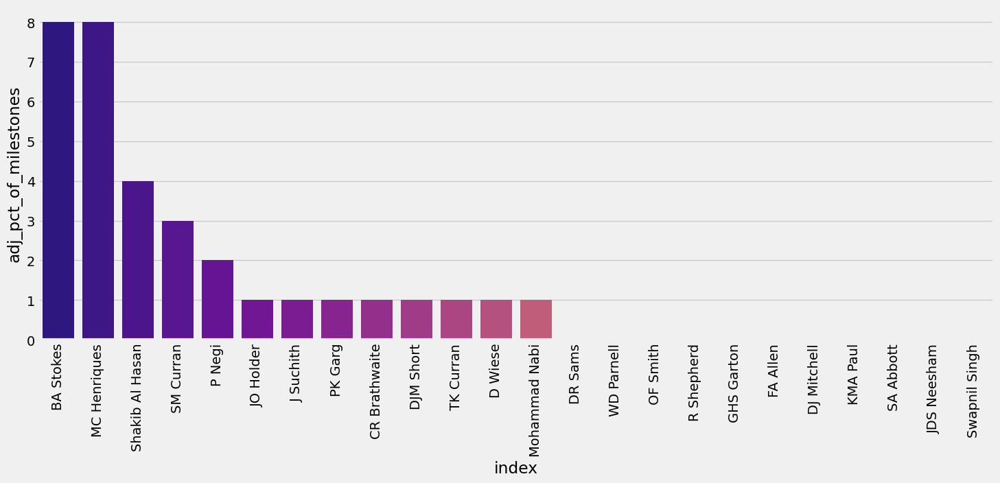

In [139]:
# sns.set_style("darkgrid")
# sns.set_palette("deep")
plt.style.use("fivethirtyeight")
plt.figure(figsize=(16, 6))
sns.barplot(data=allrounder_df.reset_index().sort_values(by='adj_pct_of_milestones', ascending=False),
            x='index', y='adj_pct_of_milestones', palette="plasma")
plt.xticks(rotation=90);

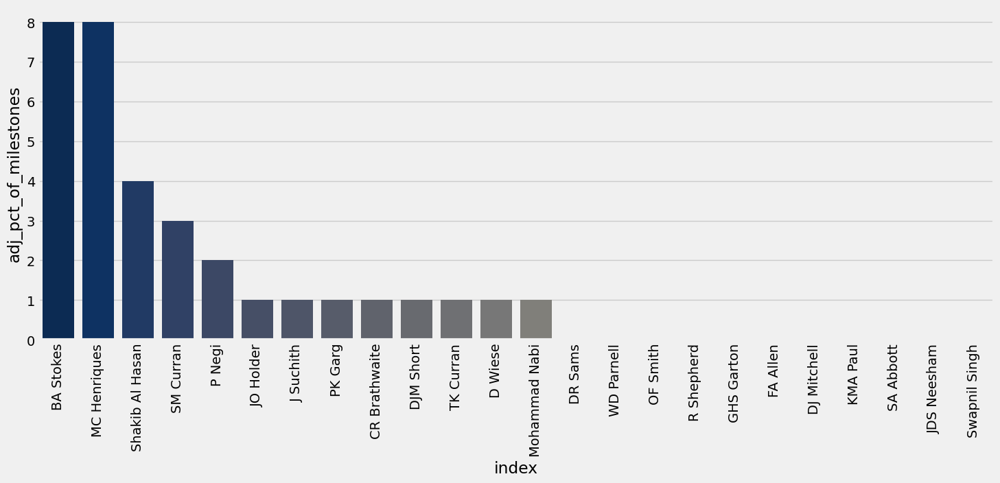

In [140]:
plt.style.use("fivethirtyeight")
plt.figure(figsize=(16, 6))
sns.barplot(data=allrounder_df.reset_index().sort_values(by='adj_pct_of_milestones', ascending=False),
            x='index', y='adj_pct_of_milestones', palette="cividis")
plt.xticks(rotation=90);

C:\Users\Moham\AppData\Local\Temp\ipykernel_19536\2317387310.py:22: UserWarning: FixedFormatter should only be used together with FixedLocator
  plt.gca().set_yticklabels([f'{x}%' for x in plt.gca().get_yticks()]);


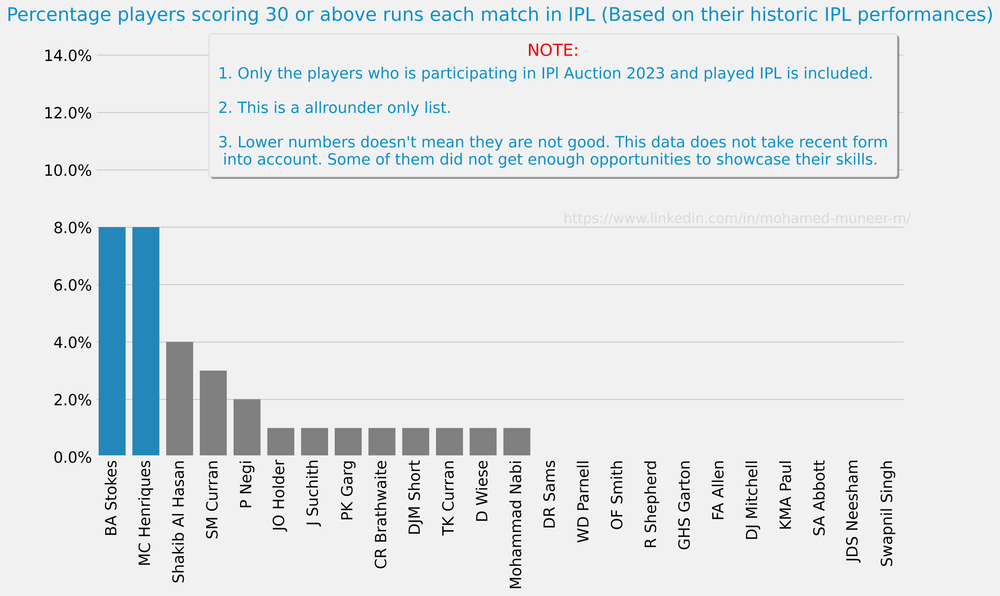

In [275]:
# palette = sns.color_palette("viridis", reverse=True)
plt.style.use("fivethirtyeight")
plt.figure(figsize=(14, 8), dpi=500)
allrounder_df_pct = allrounder_df.reset_index().sort_values(by='adj_pct_of_milestones', ascending=False)
clrs = ['grey' if (val < allrounder_df_pct['adj_pct_of_milestones'].max()) else '#0892d0' for val in allrounder_df_pct['adj_pct_of_milestones'] ]
ax = sns.barplot(data=allrounder_df_pct,
            x='index', y='adj_pct_of_milestones', palette=clrs)
plt.xticks(rotation=90);
# plt.xticks([])
plt.xlabel('');
plt.ylabel('');

plt.title('Percentage players scoring 30 or above runs each match in IPL (Based on their historic IPL performances)', color='#0892d0')
plt.ylim(0, 15)
# plt.text(0.0, 1.05, "Note: This is a sample note", transform=ax.transAxes)
legend = plt.legend(["1. Only the players who is participating in IPl Auction 2023 and played IPL is included.\n\n2. This is a allrounder only list.\n\n3. Lower numbers doesn't mean they are not good. This data does not take recent form\n into account. Some of them did not get enough opportunities to showcase their skills."], loc="upper right",
           labelcolor='#0892d0', shadow=True,
           borderpad=0.6, handlelength=0, handletextpad=0, title='NOTE:')
legend.get_title().set_color("red")
plt.figtext(.77, .51, 'https://www.linkedin.com/in/mohamed-muneer-m/',
         color='grey', ha='center', fontsize=15, wrap=True,alpha=0.2)
plt.gca().set_yticklabels([f'{x}%' for x in plt.gca().get_yticks()]);
plt.savefig('percent_above_30.png', bbox_inches="tight")

In [277]:
plt.style.use("fivethirtyeight")
sns.set_context("notebook", font_scale=1.5)
# plt.figure(figsize=(16, 8), dpi=500)
# plt.figure(figsize=(22, 12))
plt.figure(figsize=(22, 12), dpi=500)

allrounder_df_sr = allrounder_df.sort_values(by='strike_rate', ascending=False)
clrs = ['grey' if (val < allrounder_df_sr['strike_rate'].max()) else '#0892d0' for val in allrounder_df_sr['strike_rate'] ]
ax = sns.barplot(
    data=allrounder_df_sr.reset_index(),
    x='index', y='strike_rate',
    palette=clrs,)
plt.xticks(rotation=90);
plt.title('Highest strike rate by a batsmen in IPL (allrounders)', color='#0892d0', fontsize=25);
ax.bar_label(ax.containers[0], color='black');
plt.ylim(0, 300)
plt.ylabel('Strike Rate');
plt.xlabel('');
legend = plt.legend(["1. Only the players who is participating in IPl Auction 2023 and played IPL is included.\n\n2. This is a allrounder only list.\n\n3. Lower numbers doesn't mean they are not good. This data does not take recent form\n into account. Some of them did not get enough opportunities to showcase their skills."], loc="upper right",
           labelcolor='#0892d0', shadow=True,
           borderpad=0.6, handlelength=0, handletextpad=0, title='NOTE:')
legend.get_title().set_color("red")
plt.figtext(.8, .5, 'https://www.linkedin.com/in/mohamed-muneer-m/',
         color='grey', ha='center', fontsize=15, wrap=True,alpha=0.2);
# plt.figtext(0.5, 0.01, "one text and next text", ha="center", fontsize=18, bbox={"facecolor":"orange", "alpha":0.5, "pad":5})

# plt.savefig('higest_sr_ipl.png', bbox_inches="tight")

In [244]:
plt.style.use("fivethirtyeight")
sns.set_context("notebook", font_scale=1.5)
# plt.figure(figsize=(16, 8), dpi=500)
# plt.figure(figsize=(22, 12))
plt.figure(figsize=(22, 12), dpi=500)

allrounder_df_sr = allrounder_df.sort_values(by='strike_rate', ascending=False)
clrs = ['grey' if (val < allrounder_df_sr['strike_rate'].max()) else '#0892d0' for val in allrounder_df_sr['strike_rate'] ]
ax = sns.barplot(
    data=allrounder_df_sr.reset_index(),
    x='strike_rate', y='index',
    palette=clrs,
    orient = 'h')
# plt.xticks(rotation=90);
plt.title('Highest strike rate by a batsmen in IPL (allrounders)', color='#0892d0', fontsize=25);
ax.bar_label(ax.containers[0], color='black');
plt.xlim(0, 200)
plt.xlabel('Strike Rate');
plt.ylabel('');
legend = plt.legend(["1. Only the players who is participating in IPl Auction 2023 and played IPL is included.\n\n2. This is a allrounder only list.\n\n3. Lower numbers doesn't mean they are not good. This data does not take recent form\n into account. Some of them did not get enough opportunities to showcase their skills."], loc="lower right",
           labelcolor='#0892d0', shadow=True,
           borderpad=0.6, handlelength=0, handletextpad=0, title='NOTE:')
legend.get_title().set_color("red")
plt.figtext(.8, .5, 'https://www.linkedin.com/in/mohamed-muneer-m/',
         color='grey', ha='center', fontsize=15, wrap=True,alpha=0.2);
# plt.figtext(0.5, 0.01, "one text and next text", ha="center", fontsize=18, bbox={"facecolor":"orange", "alpha":0.5, "pad":5})

plt.savefig('higest_sr_ipl.png', bbox_inches="tight")

In [245]:
plt.style.use("fivethirtyeight")
sns.set_context("notebook", font_scale=1.5)
# plt.figure(figsize=(20, 12), dpi=500)
# plt.figure(figsize=(20, 12))
plt.figure(figsize=(20, 12), dpi=500)

allrounder_df_no = allrounder_df.sort_values(by='combined_notouts', ascending=False)
clrs = ['grey' if (val < allrounder_df_no['combined_notouts'].max()) else '#0892d0' for val in allrounder_df_no['combined_notouts']]
ax = sns.barplot(
    data=allrounder_df_no.reset_index(),
    x='combined_notouts', y='index',
    palette=clrs,
    orient = 'h')
# plt.xticks(rotation=90);
plt.title('Most number of Notouts in IPL (allrounders)', color='#0892d0', fontsize=25);
ax.bar_label(ax.containers[0], color='black');
plt.xlim(0, 25)
plt.xlabel('');
plt.ylabel('');
legend = plt.legend(["1. Only the players who is participating in IPl Auction 2023 and played IPL is included.\n\n2. This is a allrounder only list.\n\n3. Lower numbers doesn't mean they are not good. This data does not take recent form as well as their position\n into account. Some of them did not get enough opportunities to showcase their skills."], loc="lower right",
           labelcolor='#0892d0', shadow=True,
           borderpad=0.6, handlelength=0, handletextpad=0, title='NOTE:')
legend.get_title().set_color("red")
plt.figtext(.8, .5, 'https://www.linkedin.com/in/mohamed-muneer-m/',
         color='grey', ha='center', fontsize=15, wrap=True,alpha=0.2);
# plt.figtext(0.5, 0.01, "one text and next text", ha="center", fontsize=18, bbox={"facecolor":"orange", "alpha":0.5, "pad":5})

plt.savefig('most_num_of_notouts.png', bbox_inches="tight")

In [268]:
plt.style.use("fivethirtyeight")
sns.set_context("notebook", font_scale=1.5)
# plt.figure(figsize=(16, 8), dpi=500)
plt.figure(figsize=(20, 12))
plt.figure(figsize=(20, 12), dpi=500)
allrounder_df_avg = allrounder_df.sort_values(by='average', ascending=False)
clrs = ['grey' if (val < allrounder_df_avg['average'].max()) else '#0892d0' for val in allrounder_df_avg['average']]
ax = sns.barplot(
    data=allrounder_df_avg.reset_index(),
    x='average', y='index',
    palette=clrs,
    orient = 'h')
# plt.xticks(rotation=90);
plt.title('Best averages by a batsmens in IPL (allrounders)', color='#0892d0', fontsize=25);
ax.bar_label(ax.containers[0], color='black');
# plt.xlim(0, 25)
plt.xlabel('');
plt.ylabel('')
legend = plt.legend(["1. Only the players who is participating in IPl Auction 2023 and played IPL is included.\n\n2. This is a allrounder only list.\n\n3. Lower numbers doesn't mean they are not good. This data does not take recent form as well as their position\n into account. Some of them did not get enough opportunities to showcase their skills."], loc="lower right",
           labelcolor='#0892d0', shadow=True,
           borderpad=0.6, handlelength=0, handletextpad=0, title='NOTE:')
legend.get_title().set_color("red")
plt.figtext(.8, .5, 'https://www.linkedin.com/in/mohamed-muneer-m/',
         color='grey', ha='center', fontsize=15, wrap=True,alpha=0.2);
# plt.figtext(0.5, 0.01, "one text and next text", ha="center", fontsize=18, bbox={"facecolor":"orange", "alpha":0.5, "pad":5})

plt.savefig('best_averages_batsmen.png', bbox_inches="tight")

<Figure size 2000x1200 with 0 Axes>

In [247]:
plt.style.use("fivethirtyeight")
sns.set_context("notebook", font_scale=1.5)
# plt.figure(figsize=(16, 8), dpi=500)
plt.figure(figsize=(20, 12), dpi=500)
allrounder_df_50 = allrounder_df.sort_values(by='50s', ascending=False)
clrs = ['grey' if (val < allrounder_df_50['50s'].max()) else '#0892d0' for val in allrounder_df_50['50s']]
ax = sns.barplot(
    data=allrounder_df_50.reset_index(),
    x='50s', y='index',
    palette=clrs,
    orient = 'h')
# plt.xticks(rotation=90);
plt.title('Most no. of 50s in IPL (allrounders)', color='#0892d0', fontsize=25);
ax.bar_label(ax.containers[0], color='black');
# plt.xlim(0, 25)
plt.xlabel('');
plt.ylabel('');
legend = plt.legend(["1. Only the players who is participating in IPl Auction 2023 and played IPL is included.\n\n2. This is a allrounder only list.\n\n3. Lower numbers doesn't mean they are not good. This data does not take recent form as well as their position\n into account. Some of them did not get enough opportunities to showcase their skills."], loc="lower right",
           labelcolor='#0892d0', shadow=True,
           borderpad=0.6, handlelength=0, handletextpad=0, title='NOTE:')
legend.get_title().set_color("red")
plt.figtext(.8, .5, 'https://www.linkedin.com/in/mohamed-muneer-m/',
         color='grey', ha='center', fontsize=15, wrap=True,alpha=0.2);
# plt.figtext(0.5, 0.01, "one text and next text", ha="center", fontsize=18, bbox={"facecolor":"orange", "alpha":0.5, "pad":5})

plt.savefig('most_no_of_50s.png', bbox_inches="tight")

In [248]:
plt.style.use("fivethirtyeight")
sns.set_context("notebook", font_scale=1.5)
# plt.figure(figsize=(16, 8), dpi=500)
plt.figure(figsize=(20, 12), dpi=500)
allrounder_df_100 = allrounder_df.sort_values(by='100s', ascending=False)
clrs = ['grey' if (val < allrounder_df_100['100s'].max()) else '#0892d0' for val in allrounder_df_100['100s']]
ax = sns.barplot(
    data=allrounder_df_100.reset_index(),
    x='100s', y='index',
    palette=clrs,
    orient = 'h')
# plt.xticks(rotation=90);
plt.title('Most no. of 100s in IPL (allrounders)', color='#0892d0', fontsize=25);
ax.bar_label(ax.containers[0], color='black');
# plt.xlim(0, 25)
plt.xlabel('');
plt.ylabel('');
plt.xticks([])
legend = plt.legend(["1. Only the players who is participating in IPl Auction 2023 and played IPL is included.\n\n2. This is a allrounder only list.\n\n3. Lower numbers doesn't mean they are not good. This data does not take recent form as well as their position\n into account. Some of them did not get enough opportunities to showcase their skills."], loc="lower right",
           labelcolor='#0892d0', shadow=True,
           borderpad=0.6, handlelength=0, handletextpad=0, title='NOTE:')
legend.get_title().set_color("red")
plt.figtext(.8, .5, 'https://www.linkedin.com/in/mohamed-muneer-m/',
         color='grey', ha='center', fontsize=15, wrap=True,alpha=0.2);
# plt.figtext(0.5, 0.01, "one text and next text", ha="center", fontsize=18, bbox={"facecolor":"orange", "alpha":0.5, "pad":5})

plt.savefig('most_no_of_100s.png', bbox_inches="tight")

In [249]:
plt.style.use("fivethirtyeight")
sns.set_context("notebook", font_scale=1.5)
# plt.figure(figsize=(16, 8), dpi=500)
plt.figure(figsize=(20, 12), dpi=500)
allrounder_df_30s = allrounder_df.sort_values(by='30s', ascending=False)
clrs = ['grey' if (val < allrounder_df_30s['30s'].max()) else '#0892d0' for val in allrounder_df_30s['30s']]
ax = sns.barplot(
    data=allrounder_df_30s.reset_index(),
    x='30s', y='index',
    palette=clrs,
    orient = 'h')
# plt.xticks(rotation=90);
plt.title('Most no. of 30s in IPL (allrounders)', color='#0892d0', fontsize=25);
ax.bar_label(ax.containers[0], color='black');
# plt.xlim(0, 25)
plt.xlabel('');
plt.ylabel('');
plt.xticks([])
legend = plt.legend(["1. Only the players who is participating in IPl Auction 2023 and played IPL is included.\n\n2. This is a allrounder only list.\n\n3. Lower numbers doesn't mean they are not good. This data does not take recent form as well as their position\n into account. Some of them did not get enough opportunities to showcase their skills."], loc="lower right",
           labelcolor='#0892d0', shadow=True,
           borderpad=0.6, handlelength=0, handletextpad=0, title='NOTE:')
legend.get_title().set_color("red")
plt.figtext(.8, .5, 'https://www.linkedin.com/in/mohamed-muneer-m/',
         color='grey', ha='center', fontsize=15, wrap=True,alpha=0.2);
# plt.figtext(0.5, 0.01, "one text and next text", ha="center", fontsize=18, bbox={"facecolor":"orange", "alpha":0.5, "pad":5})

plt.savefig('most_no_of_30s.png', bbox_inches="tight")

In [250]:
plt.style.use("fivethirtyeight")
sns.set_context("notebook", font_scale=1.5)
# plt.figure(figsize=(16, 8), dpi=500)
plt.figure(figsize=(20, 12), dpi=500)
allrounder_df_avg_pp = allrounder_df.sort_values(by='avg_pp', ascending=False)
clrs = ['grey' if (val < allrounder_df_avg_pp['avg_pp'].max()) else '#0892d0' for val in allrounder_df_avg_pp['avg_pp']]
ax = sns.barplot(
    data=allrounder_df_avg_pp.reset_index(),
    x='avg_pp', y='index',
    palette=clrs,
    orient = 'h')
# plt.xticks(rotation=90);
plt.title('Best averages in powerplay by a batsmens in IPL (allrounders)', color='#0892d0', fontsize=25);
ax.bar_label(ax.containers[0], color='black');
# plt.xlim(0, 25)
plt.xlabel('');
plt.ylabel('');
legend = plt.legend(["1. Only the players who is participating in IPl Auction 2023 and played IPL is included.\n\n2. This is a allrounder only list.\n\n3. Lower numbers doesn't mean they are not good. This data does not take recent form as well as their position\n into account. Some of them did not get enough opportunities to showcase their skills."], loc="lower right",
           labelcolor='#0892d0', shadow=True,
           borderpad=0.6, handlelength=0, handletextpad=0, title='NOTE:')
legend.get_title().set_color("red")
plt.figtext(.8, .5, 'https://www.linkedin.com/in/mohamed-muneer-m/',
         color='grey', ha='center', fontsize=15, wrap=True,alpha=0.2);
# plt.figtext(0.5, 0.01, "one text and next text", ha="center", fontsize=18, bbox={"facecolor":"orange", "alpha":0.5, "pad":5})

plt.savefig('best_average_in_pp.png', bbox_inches="tight")

In [251]:
plt.style.use("fivethirtyeight")
sns.set_context("notebook", font_scale=1.5)
# plt.figure(figsize=(16, 8), dpi=500)
plt.figure(figsize=(20, 12), dpi=500)
allrounder_df_sr_pp = allrounder_df.sort_values(by='sr_pp', ascending=False)
clrs = ['grey' if (val < allrounder_df_sr_pp['sr_pp'].max()) else '#0892d0' for val in allrounder_df_sr_pp['sr_pp']]
ax = sns.barplot(
    data=allrounder_df_sr_pp.reset_index(),
    x='sr_pp', y='index',
    palette=clrs,
    orient = 'h')
# plt.xticks(rotation=90);
plt.title('Best strike rates in powerplay overs by a batsmens in IPL (allrounders)', color='#0892d0', fontsize=25);
ax.bar_label(ax.containers[0], color='black');
# plt.xlim(0, 25)
plt.xlabel('');
plt.ylabel('');
legend = plt.legend(["1. Only the players who is participating in IPl Auction 2023 and played IPL is included.\n\n2. This is a allrounder only list.\n\n3. Lower numbers doesn't mean they are not good. This data does not take recent form as well as their position\n into account. Some of them did not get enough opportunities to showcase their skills."], loc="lower right",
           labelcolor='#0892d0', shadow=True,
           borderpad=0.6, handlelength=0, handletextpad=0, title='NOTE:')
legend.get_title().set_color("red")
plt.figtext(.8, .5, 'https://www.linkedin.com/in/mohamed-muneer-m/',
         color='grey', ha='center', fontsize=15, wrap=True,alpha=0.2);
# plt.figtext(0.5, 0.01, "one text and next text", ha="center", fontsize=18, bbox={"facecolor":"orange", "alpha":0.5, "pad":5})

plt.savefig('best_sr_in_pp.png', bbox_inches="tight")

In [252]:
plt.style.use("fivethirtyeight")
sns.set_context("notebook", font_scale=1.5)
# plt.figure(figsize=(16, 8), dpi=500)
plt.figure(figsize=(20, 12), dpi=500)
allrounder_df_avg_mo = allrounder_df.sort_values(by='avg_mo', ascending=False)
clrs = ['grey' if (val < allrounder_df_avg_mo['avg_mo'].max()) else '#0892d0' for val in allrounder_df_avg_mo['avg_mo']]
ax = sns.barplot(
    data=allrounder_df_avg_mo.reset_index(),
    x='avg_mo', y='index',
    palette=clrs,
    orient = 'h')
# plt.xticks(rotation=90);
plt.title('Best averages in middle overs by a batsmens in IPL (allrounders)', color='#0892d0', fontsize=25);
ax.bar_label(ax.containers[0], color='black');
# plt.xlim(0, 25)
plt.xlabel('');
plt.ylabel('');
legend = plt.legend(["1. Only the players who is participating in IPl Auction 2023 and played IPL is included.\n\n2. This is a allrounder only list.\n\n3. Lower numbers doesn't mean they are not good. This data does not take recent form as well as their position\n into account. Some of them did not get enough opportunities to showcase their skills."], loc="lower right",
           labelcolor='#0892d0', shadow=True,
           borderpad=0.6, handlelength=0, handletextpad=0, title='NOTE:')
legend.get_title().set_color("red")
plt.figtext(.8, .5, 'https://www.linkedin.com/in/mohamed-muneer-m/',
         color='grey', ha='center', fontsize=15, wrap=True,alpha=0.2);
# plt.figtext(0.5, 0.01, "one text and next text", ha="center", fontsize=18, bbox={"facecolor":"orange", "alpha":0.5, "pad":5})

plt.savefig('best_avg_in_mo.png', bbox_inches="tight")

In [253]:
plt.style.use("fivethirtyeight")
sns.set_context("notebook", font_scale=1.5)
# plt.figure(figsize=(16, 8), dpi=500)
plt.figure(figsize=(20, 12), dpi=500)
allrounder_df_sr_mo = allrounder_df.sort_values(by='sr_mo', ascending=False)
clrs = ['grey' if (val < allrounder_df_sr_mo['sr_mo'].max()) else '#0892d0' for val in allrounder_df_sr_mo['sr_mo']]
ax = sns.barplot(
    data=allrounder_df_sr_mo.reset_index(),
    x='sr_mo', y='index',
    palette=clrs,
    orient = 'h')
# plt.xticks(rotation=90);
plt.title('Best strike rates in middle overs by a batsmens in IPL (allrounders)', color='#0892d0', fontsize=25);
ax.bar_label(ax.containers[0], color='black');
# plt.xlim(0, 25)
plt.xlabel('');
plt.ylabel('');
legend = plt.legend(["1. Only the players who is participating in IPl Auction 2023 and played IPL is included.\n\n2. This is a allrounder only list.\n\n3. Lower numbers doesn't mean they are not good. This data does not take recent form\n as well as their position into account. Some of them did not get enough opportunities\n to showcase their skills."], loc="lower right",
           labelcolor='#0892d0', shadow=True,
           borderpad=0.6, handlelength=0, handletextpad=0, title='NOTE:')
legend.get_title().set_color("red")
plt.figtext(.8, .5, 'https://www.linkedin.com/in/mohamed-muneer-m/',
         color='grey', ha='center', fontsize=15, wrap=True,alpha=0.2);
# plt.figtext(0.5, 0.01, "one text and next text", ha="center", fontsize=18, bbox={"facecolor":"orange", "alpha":0.5, "pad":5})

plt.savefig('best_sr_in_mo.png', bbox_inches="tight")

In [254]:
plt.style.use("fivethirtyeight")
sns.set_context("notebook", font_scale=1.5)
# plt.figure(figsize=(16, 8), dpi=500)
plt.figure(figsize=(20, 12), dpi=500)
allrounder_df_avg_death = allrounder_df.sort_values(by='avg_death', ascending=False)
clrs = ['grey' if (val < allrounder_df_avg_death['avg_death'].max()) else '#0892d0' for val in allrounder_df_avg_death['avg_death']]
ax = sns.barplot(
    data=allrounder_df_avg_death.reset_index(),
    x='avg_death', y='index',
    palette=clrs,
    orient = 'h')
# plt.xticks(rotation=90);
plt.title('Best averages in death overs by a batsmens in IPL (allrounders)', color='#0892d0', fontsize=25);
ax.bar_label(ax.containers[0], color='black');
# plt.xlim(0, 25)
plt.xlabel('');
plt.ylabel('');
legend = plt.legend(["1. Only the players who is participating in IPl Auction 2023 and played IPL is included.\n\n2. This is a allrounder only list.\n\n3. Lower numbers doesn't mean they are not good. This data does not take recent form as well as their position\n into account. Some of them did not get enough opportunities to showcase their skills."], loc="lower right",
           labelcolor='#0892d0', shadow=True,
           borderpad=0.6, handlelength=0, handletextpad=0, title='NOTE:')
legend.get_title().set_color("red")
plt.figtext(.8, .5, 'https://www.linkedin.com/in/mohamed-muneer-m/',
         color='grey', ha='center', fontsize=15, wrap=True,alpha=0.2);
# plt.figtext(0.5, 0.01, "one text and next text", ha="center", fontsize=18, bbox={"facecolor":"orange", "alpha":0.5, "pad":5})

plt.savefig('best_avg_in_death.png', bbox_inches="tight")

In [255]:
plt.style.use("fivethirtyeight")
sns.set_context("notebook", font_scale=1.5)
# plt.figure(figsize=(16, 8), dpi=500)
plt.figure(figsize=(22, 12), dpi=500)
allrounder_df_sr_death = allrounder_df.sort_values(by='sr_death', ascending=False)
clrs = ['grey' if (val < allrounder_df_sr_death['sr_death'].max()) else '#0892d0' for val in allrounder_df_sr_death['sr_death']]
ax = sns.barplot(
    data=allrounder_df_sr_death.reset_index(),
    x='sr_death', y='index',
    palette=clrs,
    orient = 'h')
# plt.xticks(rotation=90);
plt.title('Best strike rates in death overs by a batsmens in IPL (allrounders)', color='#0892d0', fontsize=25);
ax.bar_label(ax.containers[0], color='black');
# plt.xlim(0, 25)
plt.xlabel('');
plt.ylabel('');
legend = plt.legend(["1. Only the players who is participating in IPl Auction 2023 and played IPL is included.\n\n2. This is a allrounder only list.\n\n3. Lower numbers doesn't mean they are not good. This data does not take recent form\n as well as their position into account. Some of them did not get enough opportunities\n to showcase their skills."], loc="lower right",
           labelcolor='#0892d0', shadow=True,
           borderpad=0.6, handlelength=0, handletextpad=0, title='NOTE:')
legend.get_title().set_color("red")
plt.figtext(.8, .5, 'https://www.linkedin.com/in/mohamed-muneer-m/',
         color='grey', ha='center', fontsize=15, wrap=True,alpha=0.2);
# plt.figtext(0.5, 0.01, "one text and next text", ha="center", fontsize=18, bbox={"facecolor":"orange", "alpha":0.5, "pad":5})

plt.savefig('best_sr_in_death.png', bbox_inches="tight")

In [256]:
plt.style.use("fivethirtyeight")
sns.set_context("notebook", font_scale=1.5)
# plt.figure(figsize=(16, 8), dpi=500)
plt.figure(figsize=(22, 12), dpi=500)
allrounder_df_wickets = allrounder_df.sort_values(by='wickets', ascending=False)
clrs = ['grey' if (val < allrounder_df_wickets['wickets'].max()) else '#0892d0' for val in allrounder_df_wickets['wickets']]
ax = sns.barplot(
    data=allrounder_df_wickets.reset_index(),
    x='wickets', y='index',
    palette=clrs,
    orient = 'h')
# plt.xticks(rotation=90);
plt.title('Most wickets taken by a bowler in IPL (allrounders)', color='#0892d0', fontsize=25);
ax.bar_label(ax.containers[0], color='black');
# plt.xlim(0, 25)
plt.xlabel('');
plt.ylabel('');
legend = plt.legend(["1. Only the players who is participating in IPl Auction 2023 and played IPL is included.\n\n2. This is a allrounder only list.\n\n3. Lower numbers doesn't mean they are not good. This data does not take recent form\n as well as their position into account. Some of them did not get enough opportunities\n to showcase their skills."], loc="lower right",
           labelcolor='#0892d0', shadow=True,
           borderpad=0.6, handlelength=0, handletextpad=0, title='NOTE:')
legend.get_title().set_color("red")
plt.figtext(.8, .5, 'https://www.linkedin.com/in/mohamed-muneer-m/',
         color='grey', ha='center', fontsize=15, wrap=True,alpha=0.2);
# plt.figtext(0.5, 0.01, "one text and next text", ha="center", fontsize=18, bbox={"facecolor":"orange", "alpha":0.5, "pad":5})

plt.savefig('most_wickets_taken_bowler.png', bbox_inches="tight")

In [257]:
plt.style.use("fivethirtyeight")
sns.set_context("notebook", font_scale=1.5)
# plt.figure(figsize=(16, 8), dpi=500)
plt.figure(figsize=(22, 14), dpi=500)
allrounder_df_economy = allrounder_df.sort_values(by='economy', ascending=True)
clrs = ['grey' if (val > allrounder_df_economy['economy'].min()) else '#0892d0' for val in allrounder_df_economy['economy']]
ax = sns.barplot(
    data=allrounder_df_economy.reset_index(),
    x='economy', y='index',
    palette=clrs,
    orient = 'h')
# plt.xticks(rotation=90);
plt.title('Best economy by a bowler in IPL (allrounders)', color='#0892d0', fontsize=25);
ax.bar_label(ax.containers[0], color='black');
# plt.xlim(0, 25)
plt.xlabel('');
plt.ylabel('');
# legend = plt.legend(["1. Only the players who is participating in IPl Auction 2023 and played IPL is included.\n\n2. This is a allrounder only list.\n\n3. Lower numbers doesn't mean they are not good. This data does not take recent form\n as well as their position into account. Some of them did not get enough opportunities\n to showcase their skills."], loc="lower right",
#            labelcolor='#0892d0', shadow=True,
#            borderpad=0.6, handlelength=0, handletextpad=0, title='NOTE:')
# legend.get_title().set_color("red")
plt.figtext(.8, .5, 'https://www.linkedin.com/in/mohamed-muneer-m/',
         color='grey', ha='center', fontsize=15, wrap=True,alpha=0.2);
# plt.figtext(0.5, 0.01, "one text and next text", ha="center", fontsize=18, bbox={"facecolor":"orange", "alpha":0.5, "pad":5})

plt.savefig('best_economy_bowler.png', bbox_inches="tight")

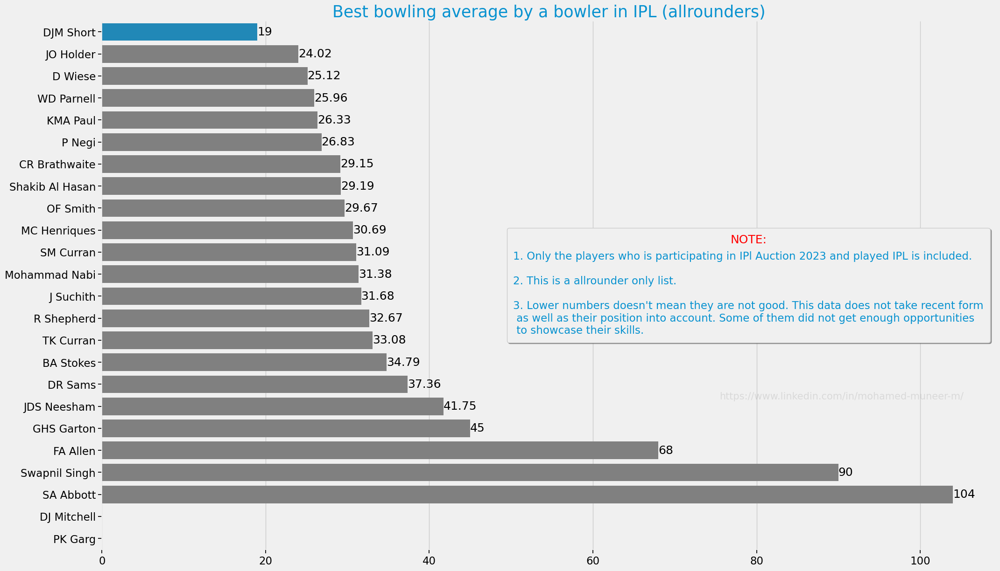

In [258]:
plt.style.use("fivethirtyeight")
sns.set_context("notebook", font_scale=1.5)
# plt.figure(figsize=(16, 8), dpi=500)
plt.figure(figsize=(22, 14))
allrounder_df_bowl_avg = allrounder_df.replace(0, np.nan).sort_values(by='bowl_avg', ascending=True)
clrs = ['grey' if (val > allrounder_df_bowl_avg['bowl_avg'].min()) else '#0892d0' for val in allrounder_df_bowl_avg['bowl_avg']]
ax = sns.barplot(
    data=allrounder_df_bowl_avg.reset_index(),
    x='bowl_avg', y='index',
    palette=clrs,
    orient = 'h')
# plt.xticks(rotation=90);
plt.title('Best bowling average by a bowler in IPL (allrounders)', color='#0892d0', fontsize=25);
ax.bar_label(ax.containers[0], color='black');
# plt.xlim(0, 25)
plt.xlabel('');
plt.ylabel('');
legend = plt.legend(["1. Only the players who is participating in IPl Auction 2023 and played IPL is included.\n\n2. This is a allrounder only list.\n\n3. Lower numbers doesn't mean they are not good. This data does not take recent form\n as well as their position into account. Some of them did not get enough opportunities\n to showcase their skills."],
            loc="center right",
           labelcolor='#0892d0', shadow=True,
           borderpad=0.6, handlelength=0, handletextpad=0, title='NOTE:')
legend.get_title().set_color("red")
plt.figtext(.8, .3, 'https://www.linkedin.com/in/mohamed-muneer-m/',
         color='grey', ha='center', fontsize=15, wrap=True,alpha=0.2);
# plt.figtext(0.5, 0.01, "one text and next text", ha="center", fontsize=18, bbox={"facecolor":"orange", "alpha":0.5, "pad":5})

plt.savefig('best_bowl_avg.png', bbox_inches="tight")

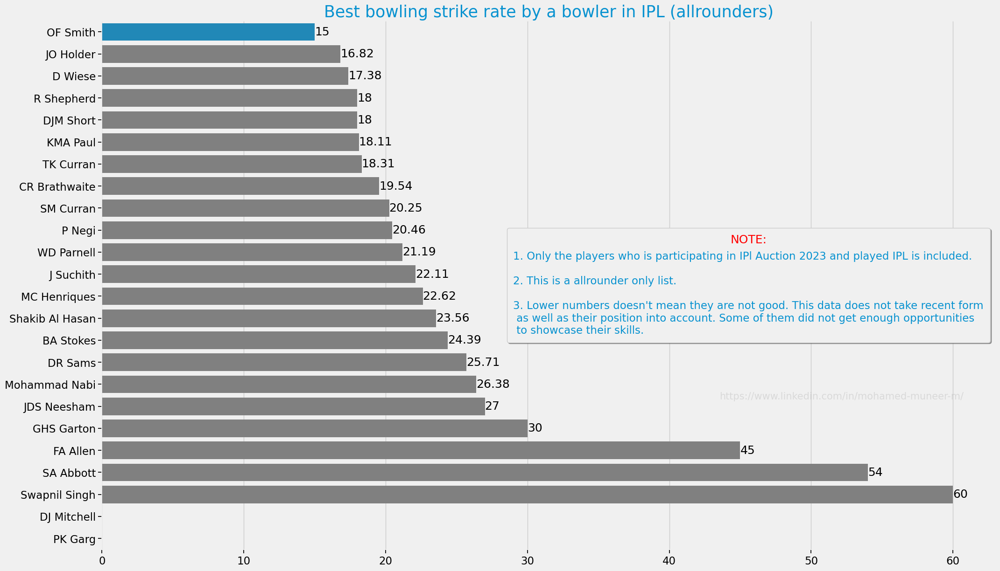

In [259]:
plt.style.use("fivethirtyeight")
sns.set_context("notebook", font_scale=1.5)
# plt.figure(figsize=(16, 8), dpi=500)
plt.figure(figsize=(22, 14))
allrounder_df_bowl_sr = allrounder_df.replace(0, np.nan).sort_values(by='bowl_sr', ascending=True)
clrs = ['grey' if (val > allrounder_df_bowl_sr['bowl_sr'].min()) else '#0892d0' for val in allrounder_df_bowl_sr['bowl_sr']]
ax = sns.barplot(
    data=allrounder_df_bowl_sr.reset_index(),
    x='bowl_sr', y='index',
    palette=clrs,
    orient = 'h')
# plt.xticks(rotation=90);
plt.title('Best bowling strike rate by a bowler in IPL (allrounders)', color='#0892d0', fontsize=25);
ax.bar_label(ax.containers[0], color='black');
# plt.xlim(0, 25)
plt.xlabel('');
plt.ylabel('');
legend = plt.legend(["1. Only the players who is participating in IPl Auction 2023 and played IPL is included.\n\n2. This is a allrounder only list.\n\n3. Lower numbers doesn't mean they are not good. This data does not take recent form\n as well as their position into account. Some of them did not get enough opportunities\n to showcase their skills."],
            loc="center right",
           labelcolor='#0892d0', shadow=True,
           borderpad=0.6, handlelength=0, handletextpad=0, title='NOTE:')
legend.get_title().set_color("red")
plt.figtext(.8, .3, 'https://www.linkedin.com/in/mohamed-muneer-m/',
         color='grey', ha='center', fontsize=15, wrap=True,alpha=0.2);
# plt.figtext(0.5, 0.01, "one text and next text", ha="center", fontsize=18, bbox={"facecolor":"orange", "alpha":0.5, "pad":5})

plt.savefig('best_sr_bowler.png', bbox_inches="tight")

In [260]:
plt.style.use("fivethirtyeight")
sns.set_context("notebook", font_scale=1.5)
# plt.figure(figsize=(16, 8), dpi=500)
plt.figure(figsize=(24, 14), dpi=500)
allrounder_df_pct_wickets = allrounder_df.sort_values(by='pct_of_getting_wicket_each_match', ascending=False)
clrs = ['grey' if (val < allrounder_df_pct_wickets['pct_of_getting_wicket_each_match'].max()) else '#0892d0' for val in allrounder_df_pct_wickets['pct_of_getting_wicket_each_match']]
ax = sns.barplot(
    data=allrounder_df_pct_wickets.reset_index(),
    x='pct_of_getting_wicket_each_match', y='index',
    palette=clrs,
    orient = 'h')
# plt.xticks(rotation=90);
plt.title('Percentange of getting a wicket in each game in IPL - based on their historical performances (allrounders)', color='#0892d0', fontsize=25);
ax.bar_label(ax.containers[0], color='black');
# plt.xlim(0, 25)
plt.xlabel('');
plt.ylabel('');
# legend = plt.legend(["1. Only the players who is participating in IPl Auction 2023 and played IPL is included.\n\n2. This is a allrounder only list.\n\n3. Lower numbers doesn't mean they are not good. This data does not take recent form\n as well as their position into account. Some of them did not get enough opportunities\n to showcase their skills."], loc="lower right",
#            labelcolor='#0892d0', shadow=True,
#            borderpad=0.6, handlelength=0, handletextpad=0, title='NOTE:')
# legend.get_title().set_color("red")
plt.figtext(.8, .5, 'https://www.linkedin.com/in/mohamed-muneer-m/',
         color='grey', ha='center', fontsize=15, wrap=True,alpha=0.2);
# plt.figtext(0.5, 0.01, "one text and next text", ha="center", fontsize=18, bbox={"facecolor":"orange", "alpha":0.5, "pad":5})

plt.savefig('pct_of_getting_wicket_each_match.png', bbox_inches="tight")

In [261]:
plt.style.use("fivethirtyeight")
sns.set_context("notebook", font_scale=1.5)
# plt.figure(figsize=(16, 8), dpi=500)
plt.figure(figsize=(24, 14), dpi=500)
allrounder_df_3w = allrounder_df.sort_values(by='3w', ascending=False)
clrs = ['grey' if (val < allrounder_df_3w['3w'].max()) else '#0892d0' for val in allrounder_df_3w['3w']]
ax = sns.barplot(
    data=allrounder_df_3w.reset_index(),
    x='3w', y='index',
    palette=clrs,
    orient = 'h')
# plt.xticks(rotation=90);
plt.title('3 wicket hauls in IPL (allrounders)', color='#0892d0', fontsize=25);
ax.bar_label(ax.containers[0], color='black');
# plt.xlim(0, 25)
plt.xlabel('');
plt.ylabel('');
legend = plt.legend(["1. Only the players who is participating in IPl Auction 2023 and played IPL is included.\n\n2. This is a allrounder only list.\n\n3. Lower numbers doesn't mean they are not good. This data does not take recent form\n as well as their position into account. Some of them did not get enough opportunities\n to showcase their skills."], loc="lower right",
           labelcolor='#0892d0', shadow=True,
           borderpad=0.6, handlelength=0, handletextpad=0, title='NOTE:')
legend.get_title().set_color("red")
plt.figtext(.8, .5, 'https://www.linkedin.com/in/mohamed-muneer-m/',
         color='grey', ha='center', fontsize=15, wrap=True,alpha=0.2);
# plt.figtext(0.5, 0.01, "one text and next text", ha="center", fontsize=18, bbox={"facecolor":"orange", "alpha":0.5, "pad":5})

plt.savefig('three_wicket_haul.png', bbox_inches="tight")

Text(0.8, 0.72, 'https://www.linkedin.com/in/mohamed-muneer-m/')

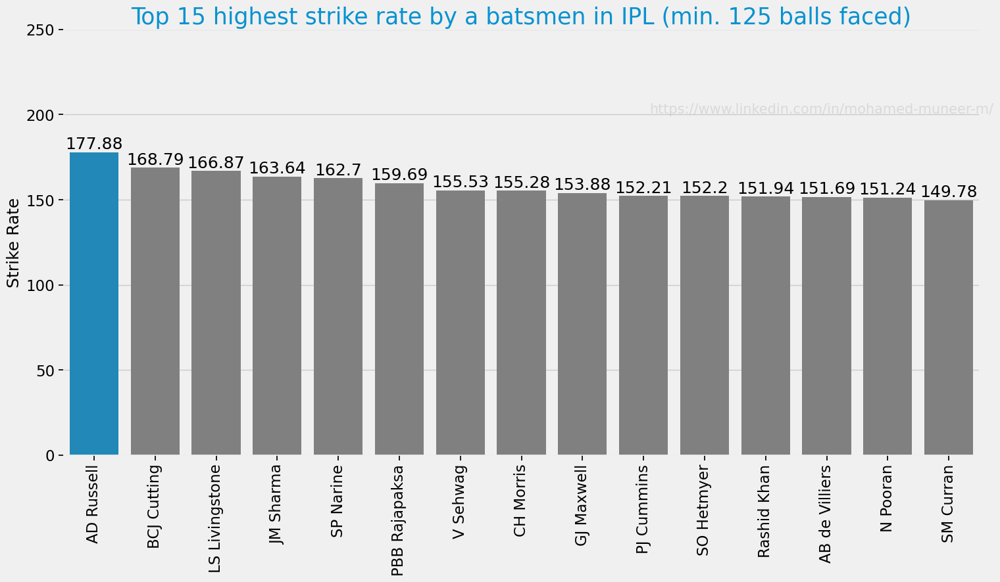

In [262]:
plt.style.use("fivethirtyeight")
sns.set_context("notebook", font_scale=1.5)
# plt.figure(figsize=(16, 8), dpi=500)
plt.figure(figsize=(16, 8))

clrs = ['grey' if (val < sr['strike_rate'].max()) else '#0892d0' for val in sr['strike_rate'] ]
ax = sns.barplot(data=sr.reset_index(), x='index', y='strike_rate', palette=clrs)
plt.xticks(rotation=90);
plt.title('Top 15 highest strike rate by a batsmen in IPL (min. 125 balls faced)', color='#0892d0', fontsize=25);
ax.bar_label(ax.containers[0], color='black');
plt.ylim(0, 250)
plt.xlabel('');
plt.ylabel('Strike Rate');
plt.figtext(.8, .72, 'https://www.linkedin.com/in/mohamed-muneer-m/',
         color='grey', ha='center', fontsize=15, wrap=True,alpha=0.2)
# plt.figtext(0.5, 0.01, "one text and next text", ha="center", fontsize=18, bbox={"facecolor":"orange", "alpha":0.5, "pad":5})

# plt.savefig('higest_sr_ipl.png', bbox_inches="tight")

In [265]:
sns.barplot

<function seaborn.categorical.barplot(data=None, *, x=None, y=None, hue=None, order=None, hue_order=None, estimator='mean', errorbar=('ci', 95), n_boot=1000, units=None, seed=None, orient=None, color=None, palette=None, saturation=0.75, width=0.8, errcolor='.26', errwidth=None, capsize=None, dodge=True, ci='deprecated', ax=None, **kwargs)>